# Object Detection Demo
Welcome to the object detection inference walkthrough!  This notebook will walk you step by step through the process of using a pre-trained model to detect objects in an image. Make sure to follow the [installation instructions](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/installation.md) before you start.

# Imports

In [2]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

if tf.__version__ < '1.4.0':
  raise ImportError('Please upgrade your tensorflow installation to v1.4.* or later!')


## Env setup

In [3]:
# This is needed to display the images.
%matplotlib inline

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")

## Object detection imports
Here are the imports from the object detection module.

In [4]:
from utils import label_map_util

from utils import visualization_utils as vis_util

# Model preparation 

## Variables

Any model exported using the `export_inference_graph.py` tool can be loaded here simply by changing `PATH_TO_CKPT` to point to a new .pb file.  

By default we use an "SSD with Mobilenet" model here. See the [detection model zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md) for a list of other models that can be run out-of-the-box with varying speeds and accuracies.

In [5]:
# What model to download.
MODEL_NAME = 'ssd_mobilenet_v1_coco_2017_11_17'
MODEL_FILE = MODEL_NAME + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = MODEL_NAME + '/frozen_inference_graph.pb'

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = os.path.join('data', 'mscoco_label_map.pbtxt')

NUM_CLASSES = 90

## Download Model

In [6]:
opener = urllib.request.URLopener()
opener.retrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)
tar_file = tarfile.open(MODEL_FILE)
for file in tar_file.getmembers():
  file_name = os.path.basename(file.name)
  if 'frozen_inference_graph.pb' in file_name:
    tar_file.extract(file, os.getcwd())

## Load a (frozen) Tensorflow model into memory.

In [7]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

In [8]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

## Helper code

In [9]:
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

# Detection

In [10]:
# For the sake of simplicity we will use only 2 images:
# image1.jpg
# image2.jpg
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images'
TEST_IMAGE_PATHS = [ os.path.join(PATH_TO_TEST_IMAGES_DIR, 'image{}.jpg'.format(i)) for i in range(1, 3) ]

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)                                                                              

(171.0, 289.0)
(542.5, 515.5)


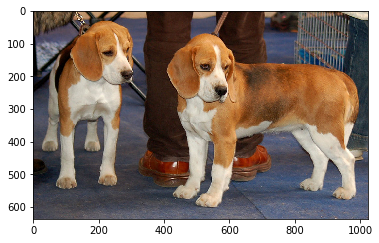

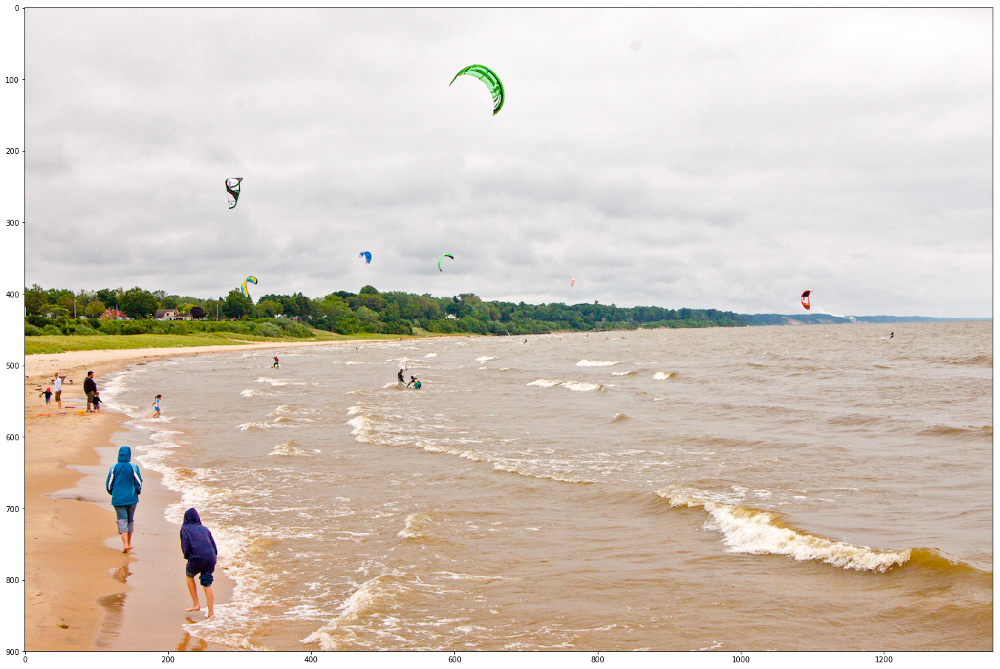

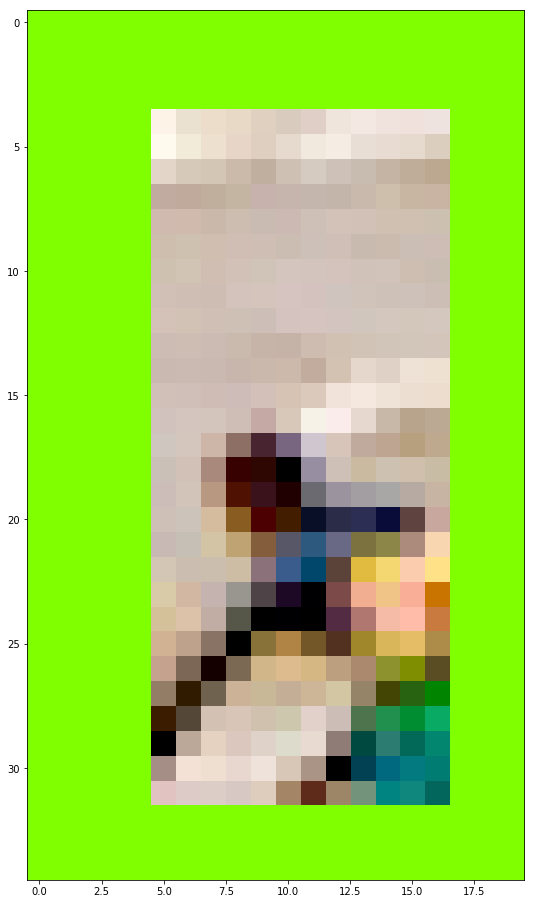

In [32]:
with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        for image_path in TEST_IMAGE_PATHS:
            image = Image.open(image_path)
            height, width = image.size
            # the array based representation of the image will be used later in order to prepare the
            # result image with boxes and labels on it.
            image_np = load_image_into_numpy_array(image)
            # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
            image_np_expanded = np.expand_dims(image_np, axis=0)
            # Actual detection.
            (boxes, scores, classes, num) = sess.run(
              [detection_boxes, detection_scores, detection_classes, num_detections],
              feed_dict={image_tensor: image_np_expanded})
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np,
                np.squeeze(boxes),
                np.squeeze(classes).astype(np.int32),
                np.squeeze(scores),
                category_index,
                use_normalized_coordinates=True,
                line_thickness=8)
            plt.imshow(image)
            for i in range(1):
                print(getAbsoluteCentroid(image, boxes, 0))
                y_min, x_min, y_max, x_max = np.squeeze(boxes)[i]
                y_min *= width
                y_max *= width
                x_min *= height
                x_max *= height
#                 wow = tf.image.crop_to_bounding_box(image_np, int(y_min), int(x_min), int(y_max - y_min), int(x_max - x_min))
                plt.figure(figsize=IMAGE_SIZE)
    #             plt.imshow(image_np)
                plt.imshow(tf.image.crop_to_bounding_box(image_np, int(y_min), int(x_min), int(y_max - y_min), int(x_max - x_min)).eval())


In [13]:
# print(sqzBox)
print(sqzBox[0])
print(y_min, x_min, y_max, x_max)
print(int(y_min), int(x_min), int(y_max - y_min), int(x_max - x_min))


NameError: name 'sqzBox' is not defined

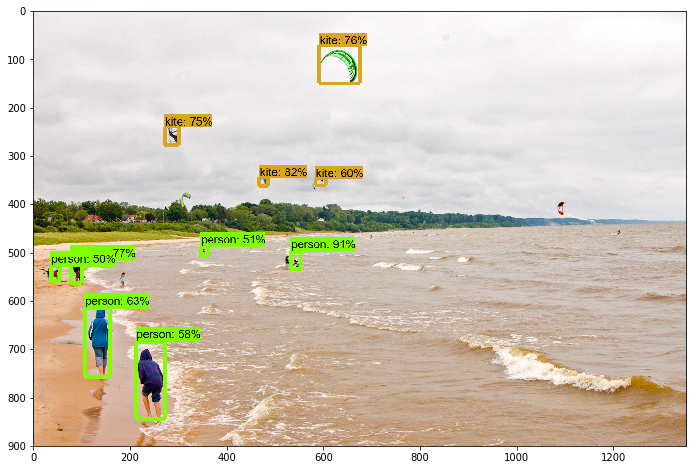

In [14]:
vis_util.visualize_boxes_and_labels_on_image_array(
    image_np,
    np.squeeze(boxes),
    np.squeeze(classes).astype(np.int32),
    np.squeeze(scores),
    category_index,
    use_normalized_coordinates=True,
    line_thickness=8)
plt.figure(figsize=IMAGE_SIZE)
plt.imshow(image_np)

# VIDEO

In [15]:
import cv2

def loadVideoIntoQueue(filename):
    #https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_gui/py_video_display/py_video_display.html
    #https://stackoverflow.com/questions/33311153/python-extracting-and-saving-video-frames

    cap = cv2.VideoCapture(filename)

    while(True):
        # Capture frame-by-frame
        ret, frame = cap.read()
        if ret == False:
            break

        # Our operations on the frame come here
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Display the resulting frame
        cv2.imshow('frame',gray)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # When everything done, release the capture
    cap.release()
    cv2.destroyAllWindows()
    
loadVideoIntoQueue('test_videos/bottle.MOV')

test_videos/bottle.MOV


error: C:\projects\opencv-python\opencv\modules\imgproc\src\color.cpp:11079: error: (-215) scn == 3 || scn == 4 in function cv::cvtColor


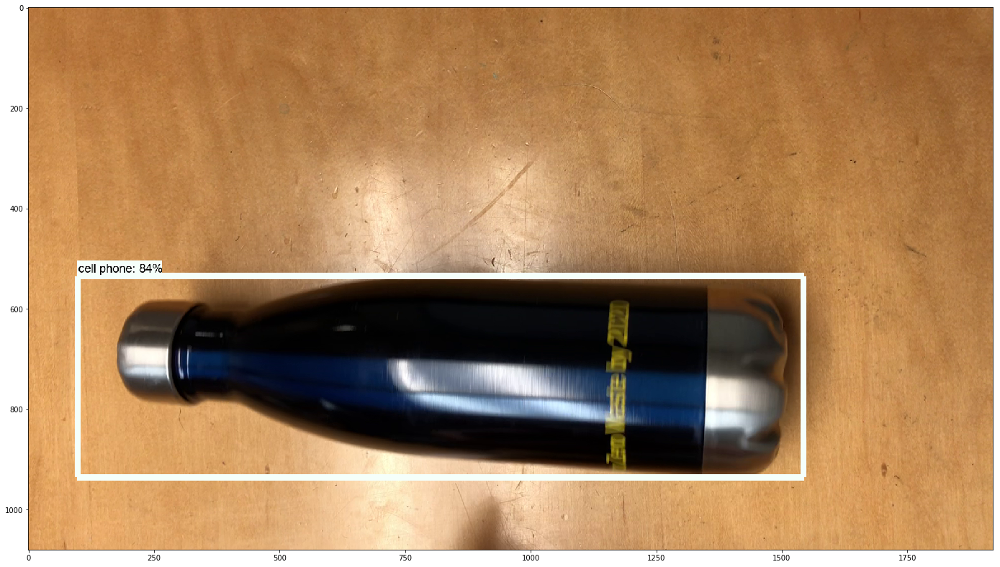

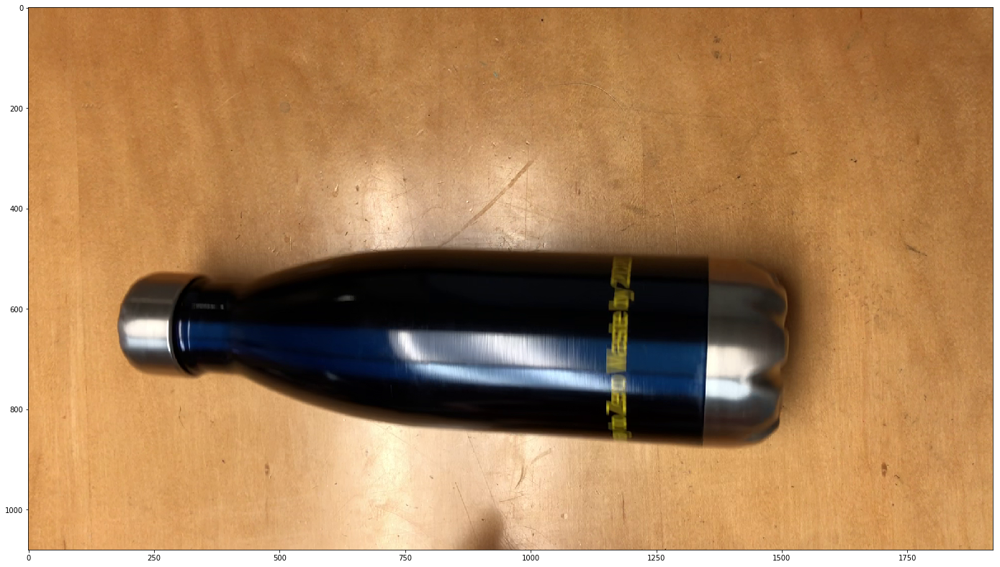

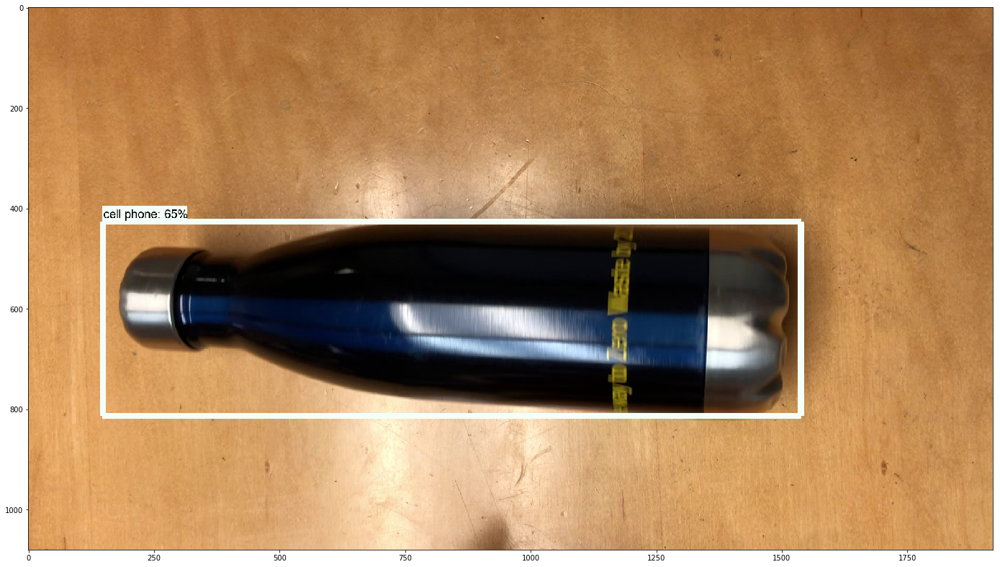

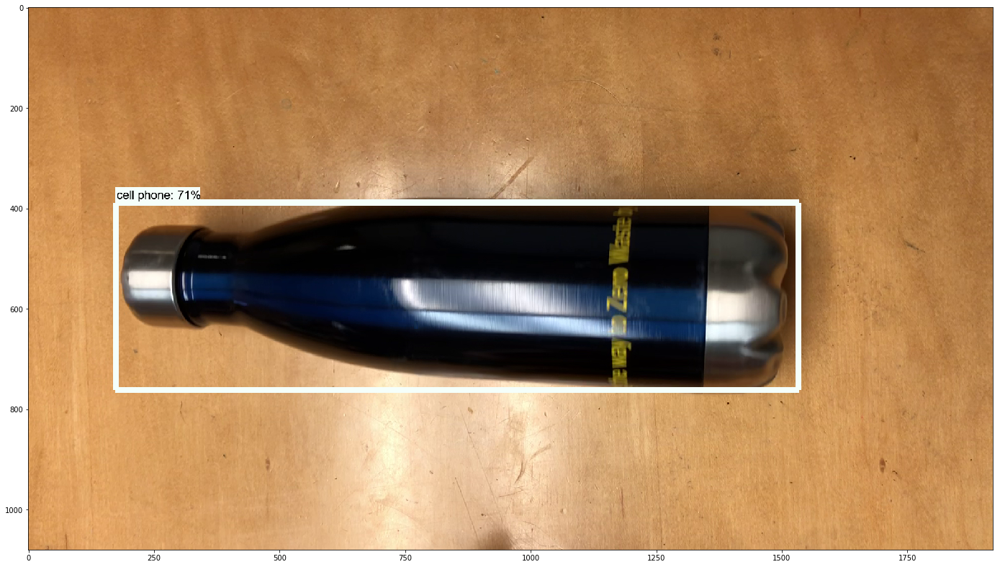

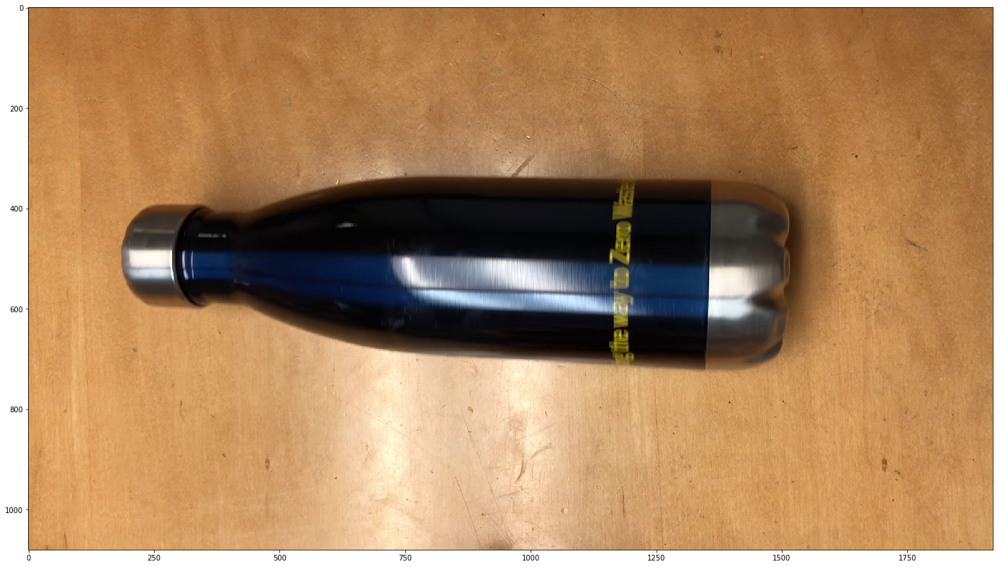

...

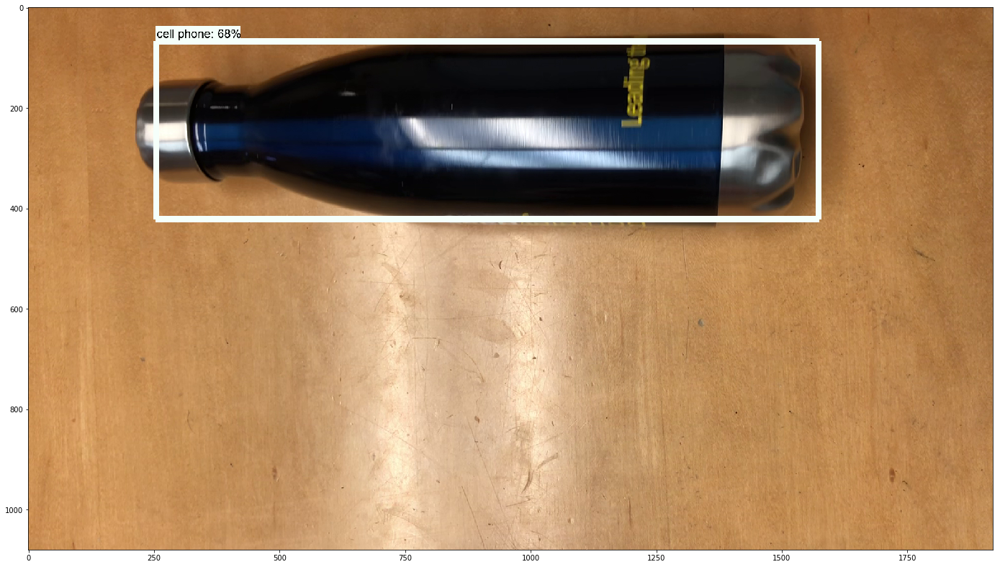

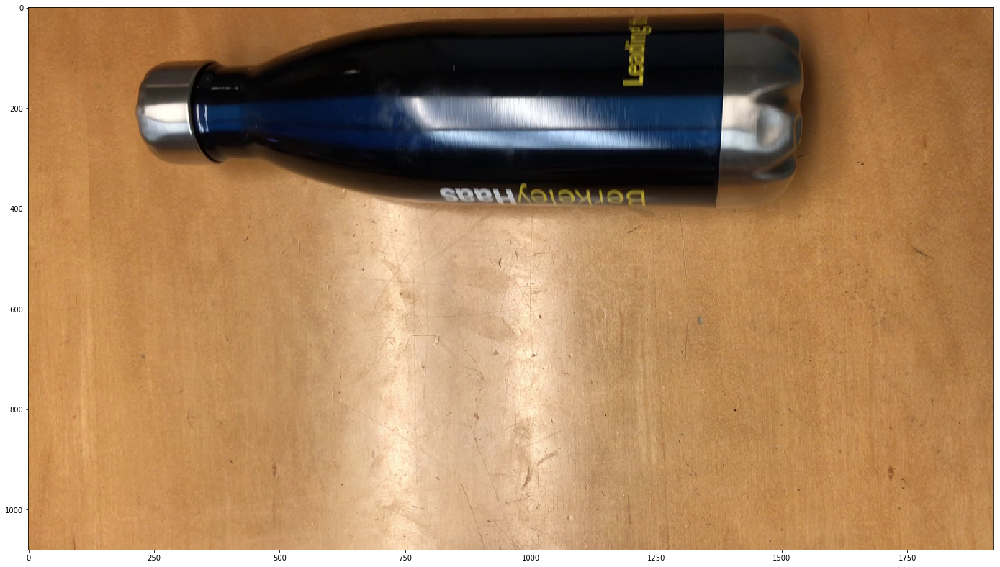

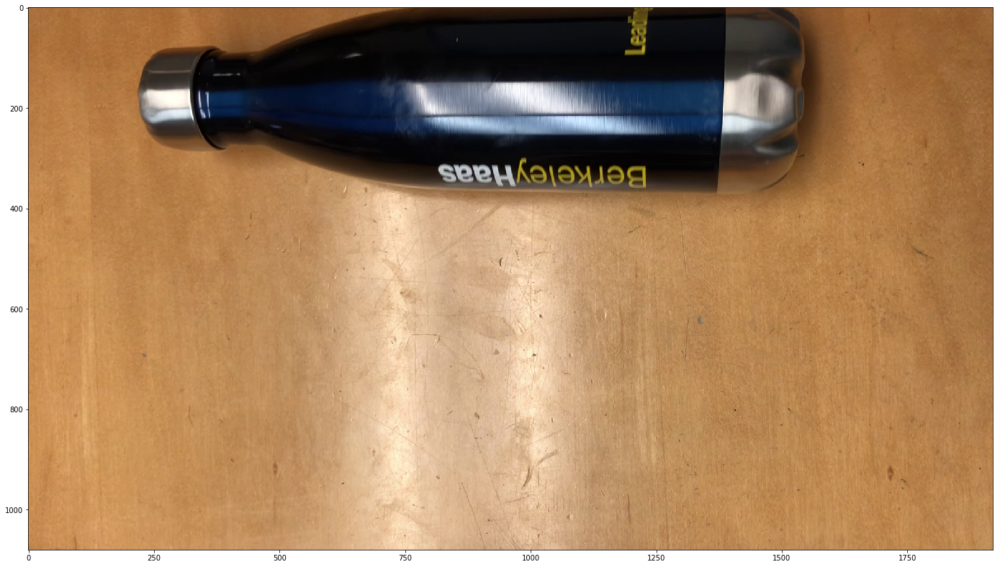

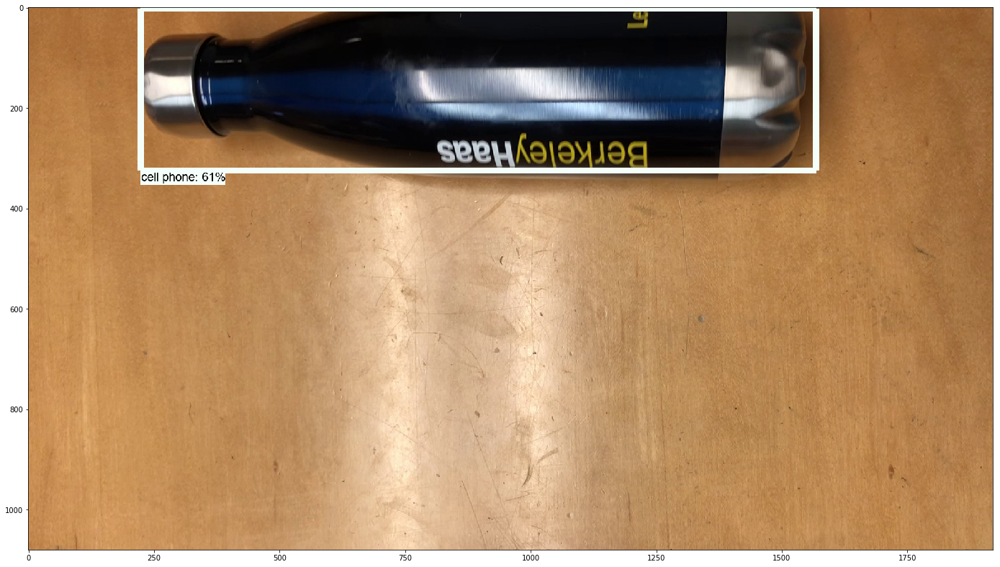

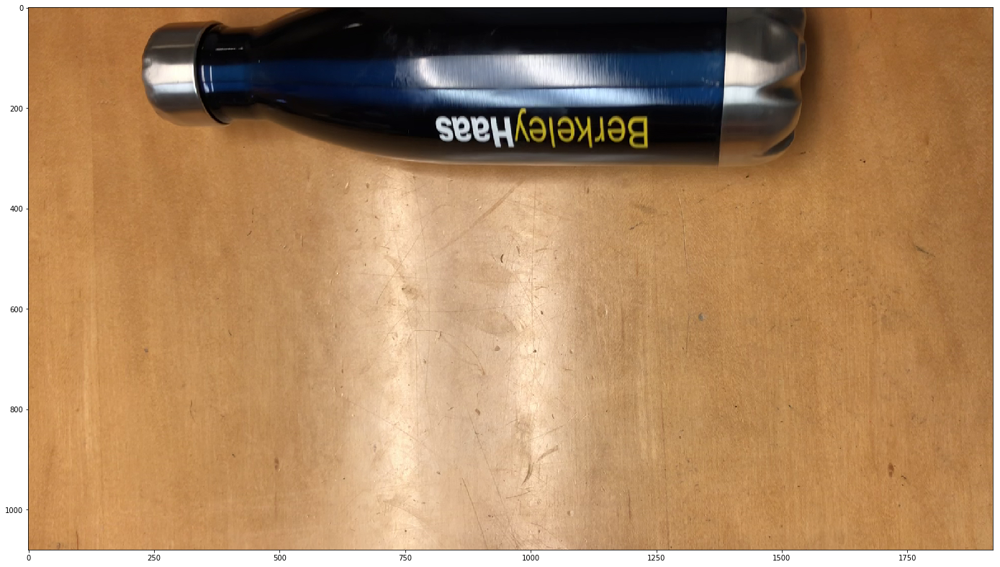

In [16]:
import cv2
import tensorflow as tf


detection_graph = tf.Graph()


with detection_graph.as_default():
 od_graph_def = tf.GraphDef()
 with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
   serialized_graph = fid.read()
   od_graph_def.ParseFromString(serialized_graph)
   tf.import_graph_def(od_graph_def, name='')


def detect_objects(image_np, sess, detection_graph):
   # Definite input and output Tensors for detection_graph
   image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
   # Each box represents a part of the image where a particular object was detected.
   detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
   # Each score represent how level of confidence for each of the objects.
   # Score is shown on the result image, together with the class label.
   detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
   detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
   num_detections = detection_graph.get_tensor_by_name('num_detections:0')
   
   image_np_expanded = np.expand_dims(image_np, axis=0)

   (boxes, scores, classes, num) = sess.run(
         [detection_boxes, detection_scores, detection_classes, num_detections],
         feed_dict={image_tensor: image_np_expanded})
   
   
   vis_util.visualize_boxes_and_labels_on_image_array(
       image_np,
       np.squeeze(boxes),
       np.squeeze(classes).astype(np.int32),
       np.squeeze(scores),
       category_index,
       use_normalized_coordinates=True,
       line_thickness=12)
   return image_np

filename = 'test_videos/bottle.MOV'
print(filename)

cap = cv2.VideoCapture(filename)
IMAGE_SIZE = (24, 16)

frame_num = 0

with detection_graph.as_default():
 with tf.Session(graph=detection_graph) as sess:
   
   while(cap.isOpened()):
       ret, frame = cap.read()
       if frame_num % 5 == 0:
           frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
       
           image_np = detect_objects(frame_rgb, sess, detection_graph)
       
           plt.figure(figsize=IMAGE_SIZE)
           plt.imshow(image_np)
           
       frame_num += 1


cap.release()
cv2.destroyAllWindows()

(542.5, 515.5)

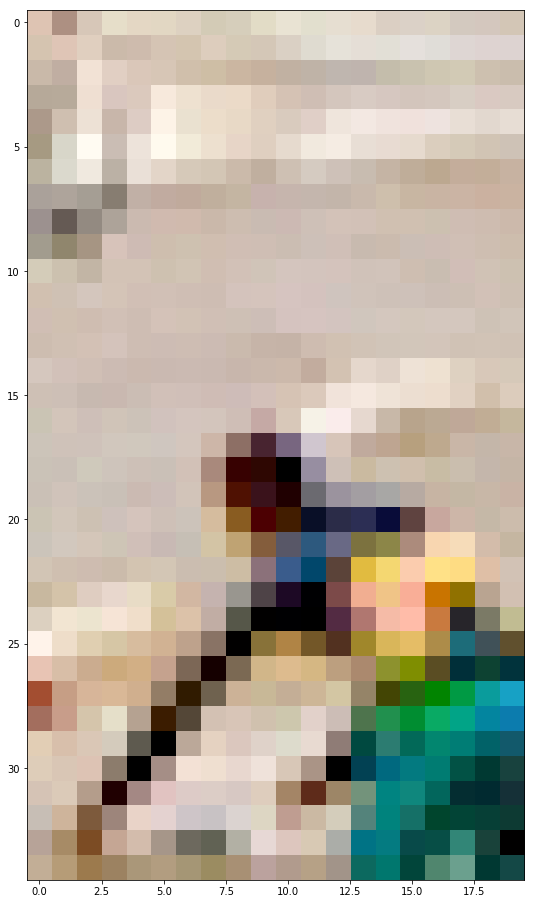

In [29]:
def cropBoundingBox(image, boxes, i):
    with detection_graph.as_default():
        with tf.Session(graph=detection_graph) as sess:
            y_min, x_min, y_max, x_max = np.squeeze(boxes)[i]
            y_min *= width
            y_max *= width
            x_min *= height
            x_max *= height
            croppedBox = tf.image.crop_to_bounding_box(image, int(y_min), int(x_min), int(y_max - y_min), int(x_max - x_min)).eval()
            return croppedBox

plt.figure(figsize=IMAGE_SIZE)
plt.imshow(cropBoundingBox(image, boxes, 0))

def getAbsoluteCentroid(image, boxes, i):
    height, width = image.size
    y_min, x_min, y_max, x_max = np.squeeze(boxes)[i]
    y_min *= width
    y_max *= width
    x_min *= height
    x_max *= height
    return (int(x_min) + ((int(x_max) - int(x_min))/2), int(y_min) + ((int(y_max) - int(y_min))/2))

getAbsoluteCentroid(image, boxes, 0)

